# osmnx_2021-04-02-US-SJC-1

In [1]:
import os
import pandas as pd
import numpy as np
import ipynb_path
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
import seaborn as sns
import plotly
import plotly.express as px
%matplotlib inline
pd.set_option('display.max_rows', 200)

In [2]:
target = '2021-04-02-US-SJC-1'

In [3]:
def visualize_trafic(df, center, zoom=9):
    fig = px.scatter_mapbox(df,
                            
                            # Here, plotly gets, (x,y) coordinates
                            lat="latDeg",
                            lon="lngDeg",
                            
                            #Here, plotly detects color of series
                            color="phoneName",
                            labels="phoneName",
                            
                            zoom=zoom,
                            center=center,
                            height=1000,
                            width=2000)
    fig.update_layout(mapbox_style='stamen-terrain')
    fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
    fig.update_layout(title_text="GPS trafic")
    fig.show()

In [4]:
def visualize_collection(df, collection):
    target_df = df[df['collectionName']==collection].copy()
    lat_center = target_df['latDeg'].mean()
    lng_center = target_df['lngDeg'].mean()
    center = {"lat":lat_center, "lon":lng_center}
    
    visualize_trafic(target_df, center)

In [5]:
def calc_haversine(lat1, lon1, lat2, lon2):
    """Calculates the great circle distance between two points
    on the earth. Inputs are array-like and specified in decimal degrees.
    """
    RADIUS = 6_367_000
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + \
        np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    dist = 2 * RADIUS * np.arcsin(a**0.5)
    return dist

In [6]:
# directory setting
INPUT = '../input/google-smartphone-decimeter-challenge'

In [7]:
# reading data
base_train = pd.read_csv(INPUT + '/' + 'baseline_locations_train.csv')
base_test = pd.read_csv(INPUT + '/' + 'baseline_locations_test.csv')
sample_sub = pd.read_csv(INPUT + '/' + 'sample_submission.csv')
ground_truth = pd.read_csv(INPUT + '/prep/ground_truth_train.csv')

In [8]:
base_train['phone'] = base_train['collectionName'] + '_' + base_train['phoneName']
ground_truth['phone'] = ground_truth['collectionName'] + '_' + ground_truth['phoneName']

In [9]:
test = base_test[base_test['collectionName']==target].copy()

In [10]:
def remove_based_on_gt(target_df, target_gt, th):
    for idx in target_df.index:
        lat = target_df.at[idx, 'latDeg']
        lng = target_df.at[idx, 'lngDeg']
        s = target_df.at[idx, 'millisSinceGpsEpoch']
        
        if np.isnan(lat):
            continue
        else:
            target_gt['latDeg_pred'] = lat
            target_gt['lngDeg_pred'] = lng
            target_gt['dist'] = calc_haversine(target_gt['latDeg'], target_gt['lngDeg'], target_gt['latDeg_pred'], target_gt['lngDeg_pred'])
            closest_dist = target_gt['dist'].min()
            if closest_dist > th:
                target_df.at[idx, 'latDeg'] = np.nan
                target_df.at[idx, 'lngDeg'] = np.nan
    return target_df

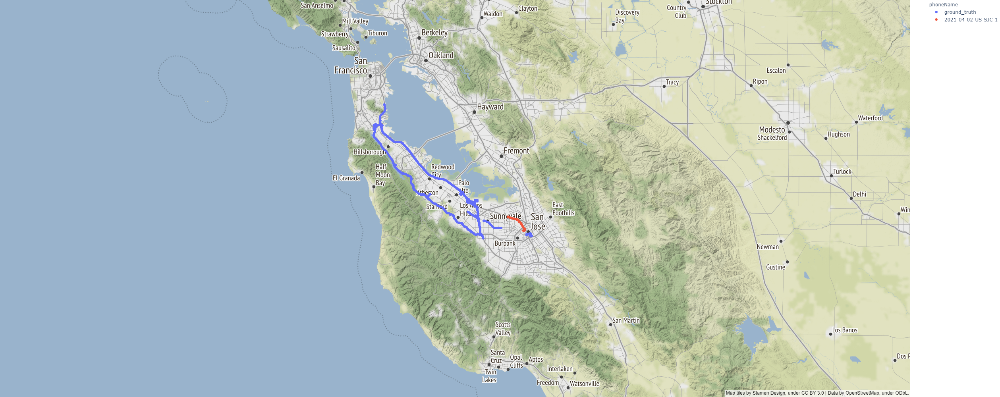

In [11]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = test.copy()
tmp2['phoneName'] = target
tmp = pd.concat([tmp1, tmp2])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

In [12]:
from shapely.geometry import Point
import osmnx as ox
import momepy
import geopandas as gpd

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning:

The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.



In [13]:
# change pd.DataFrame -> gpd.GeoDataFrame
test["geometry"] = [Point(p) for p in test[["lngDeg", "latDeg"]].to_numpy()]
test_gdf = gpd.GeoDataFrame(test, geometry=test["geometry"])

In [14]:
# get road data from open street map by osmnx
offset = (0.1**3)
bbox = test_gdf.bounds + [-offset, -offset, offset, offset]
east = bbox["minx"].min()
west = bbox["maxx"].max()
south = bbox["miny"].min()
north = bbox["maxy"].max()
G = ox.graph.graph_from_bbox(north, south, east, west, network_type='drive')

In [15]:
ox.folium.plot_graph_folium(G)

In [16]:
nodes, edges = momepy.nx_to_gdf(G)

/opt/conda/lib/python3.7/site-packages/momepy/utils.py:418: UserWarning:

Approach is not set. Defaulting to 'primal'.



<AxesSubplot:>

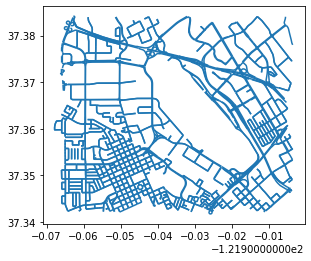

In [17]:
edges.plot()

In [18]:
edges.head()

,osmid,name,highway,oneway,length,lanes,geometry,ref,maxspeed,bridge,access,junction,tunnel,node_start,node_end
0,28617114,Benton Street,secondary,False,21.658,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,0,3
1,"[682723429, 682723430, 715145675, 28596205, 35...","[Benton Street, Railroad Avenue]",residential,False,350.082,"[3, 2]","LINESTRING (-121.93833 37.35309, -121.93823 37...",NaN,NaN,NaN,NaN,NaN,NaN,0,628
2,358444826,El Camino Real,primary,True,194.176,3,"LINESTRING (-121.93833 37.35309, -121.93852 37...",CA 82,30 mph,NaN,NaN,NaN,NaN,0,732
3,"[416143548, 256244332]",El Camino Real,primary,True,59.301,NaN,"LINESTRING (-121.94515 37.35531, -121.94531 37...",CA 82,40 mph,NaN,NaN,NaN,NaN,1,959
4,"[256244324, 416151830]",El Camino Real,primary,True,114.788,"[3, 4]","LINESTRING (-121.95189 37.35268, -121.95137 37...",CA 82,40 mph,NaN,NaN,NaN,NaN,2,614


In [19]:
edges = edges.dropna(subset=["geometry"]).reset_index(drop=True)
hits = bbox.apply(lambda row: list(edges.sindex.intersection(row)), axis=1)
tmp = pd.DataFrame({
    # index of points table
    "pt_idx": np.repeat(hits.index, hits.apply(len)),
    # ordinal position of line - access via iloc later
    "line_i": np.concatenate(hits.values)
})
# Join back to the lines on line_i; we use reset_index() to 
# give us the ordinal position of each line
tmp = tmp.join(edges.reset_index(drop=True), on="line_i")
# Join back to the original points to get their geometry
# rename the point geometry as "point"
tmp = tmp.join(test_gdf.geometry.rename("point"), on="pt_idx")
# Convert back to a GeoDataFrame, so we can do spatial ops
tmp = gpd.GeoDataFrame(tmp, geometry="geometry", crs=test_gdf.crs)

In [20]:
tmp.head()

,pt_idx,line_i,osmid,name,highway,oneway,length,lanes,geometry,ref,maxspeed,bridge,access,junction,tunnel,node_start,node_end,point
0,62132,1305,28458326,Walnut Street,residential,False,142.200,NaN,"LINESTRING (-121.91071 37.34415, -121.90979 37...",NaN,NaN,NaN,NaN,NaN,NaN,513,680,POINT (-121.90973 37.34509)
1,62132,1536,28458326,Walnut Street,residential,False,142.200,NaN,"LINESTRING (-121.90965 37.34318, -121.90979 37...",NaN,NaN,NaN,NaN,NaN,NaN,680,513,POINT (-121.90973 37.34509)
2,62132,972,8968325,Asbury Street,residential,False,145.619,NaN,"LINESTRING (-121.91194 37.34328, -121.91185 37...",NaN,25 mph,NaN,NaN,NaN,NaN,387,513,POINT (-121.90973 37.34509)
3,62132,1285,"[8968325, 8962903]","[Irene Street, Asbury Street]",residential,False,323.199,NaN,"LINESTRING (-121.90690 37.34523, -121.90695 37...",NaN,25 mph,NaN,NaN,NaN,NaN,505,498,POINT (-121.90973 37.34509)
4,62132,1269,"[8968325, 8962903]","[Irene Street, Asbury Street]",residential,False,323.199,NaN,"LINESTRING (-121.90951 37.34495, -121.90941 37...",NaN,25 mph,NaN,NaN,NaN,NaN,498,505,POINT (-121.90973 37.34509)


In [21]:
tmp

,pt_idx,line_i,osmid,name,highway,oneway,length,lanes,geometry,ref,maxspeed,bridge,access,junction,tunnel,node_start,node_end,point
0,62132,1305,28458326,Walnut Street,residential,False,142.200,NaN,"LINESTRING (-121.91071 37.34415, -121.90979 37...",NaN,NaN,NaN,NaN,NaN,NaN,513,680,POINT (-121.90973 37.34509)
1,62132,1536,28458326,Walnut Street,residential,False,142.200,NaN,"LINESTRING (-121.90965 37.34318, -121.90979 37...",NaN,NaN,NaN,NaN,NaN,NaN,680,513,POINT (-121.90973 37.34509)
2,62132,972,8968325,Asbury Street,residential,False,145.619,NaN,"LINESTRING (-121.91194 37.34328, -121.91185 37...",NaN,25 mph,NaN,NaN,NaN,NaN,387,513,POINT (-121.90973 37.34509)
3,62132,1285,"[8968325, 8962903]","[Irene Street, Asbury Street]",residential,False,323.199,NaN,"LINESTRING (-121.90690 37.34523, -121.90695 37...",NaN,25 mph,NaN,NaN,NaN,NaN,505,498,POINT (-121.90973 37.34509)
4,62132,1269,"[8968325, 8962903]","[Irene Street, Asbury Street]",residential,False,323.199,NaN,"LINESTRING (-121.90951 37.34495, -121.90941 37...",NaN,25 mph,NaN,NaN,NaN,NaN,498,505,POINT (-121.90973 37.34509)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46994,66880,1269,"[8968325, 8962903]","[Irene Street, Asbury Street]",residential,False,323.199,NaN,"LINESTRING (-121.90951 37.34495, -121.90941 37...",NaN,25 mph,NaN,NaN,NaN,NaN,498,505,POINT (-121.90964 37.34517)
46995,66880,1271,218678552,Spring Street,residential,False,129.349,NaN,"LINESTRING (-121.90951 37.34495, -121.90946 37...",NaN,NaN,NaN,NaN,NaN,NaN,498,497,POINT (-121.90964 37.34517)
46996,66880,1268,218678552,Spring Street,residential,False,129.349,NaN,"LINESTRING (-121.90853 37.34409, -121.90859 37...",NaN,NaN,NaN,NaN,NaN,NaN,497,498,POINT (-121.90964 37.34517)
46997,66880,1177,218678552,Spring Street,residential,False,443.228,NaN,"LINESTRING (-121.91278 37.34797, -121.91271 37...",NaN,NaN,NaN,NaN,NaN,NaN,461,498,POINT (-121.90964 37.34517)


In [22]:
tmp["snap_dist"] = tmp.geometry.distance(gpd.GeoSeries(tmp.point))

# Discard any lines that are greater than tolerance from points
tolerance = 0.0010  
tmp = tmp.loc[tmp.snap_dist <= tolerance]
# Sort on ascending snap distance, so that closest goes to top
tmp = tmp.sort_values(by=["snap_dist"])

# group by the index of the points and take the first, which is the
# closest line 
closest = tmp.groupby("pt_idx").first()
# construct a GeoDataFrame of the closest lines
closest = gpd.GeoDataFrame(closest, geometry="geometry")
closest = closest.drop_duplicates("line_i").reset_index(drop=True)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None




<AxesSubplot:>

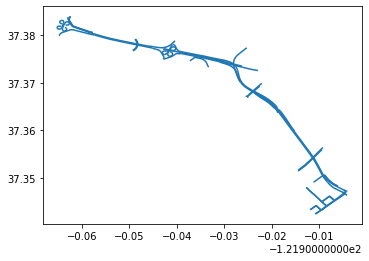

In [23]:
closest.plot()

In [24]:
line_points_list = []
split = 50  # param: number of split in each LineString
for dist in range(0, split, 1):
    dist = dist/split
    line_points = closest["geometry"].interpolate(dist, normalized=True)
    line_points_list.append(line_points)
line_points = pd.concat(line_points_list).reset_index(drop=True)
line_points = line_points.reset_index().rename(columns={0:"geometry"})
line_points["lngDeg"] = line_points["geometry"].x
line_points["latDeg"] = line_points["geometry"].y

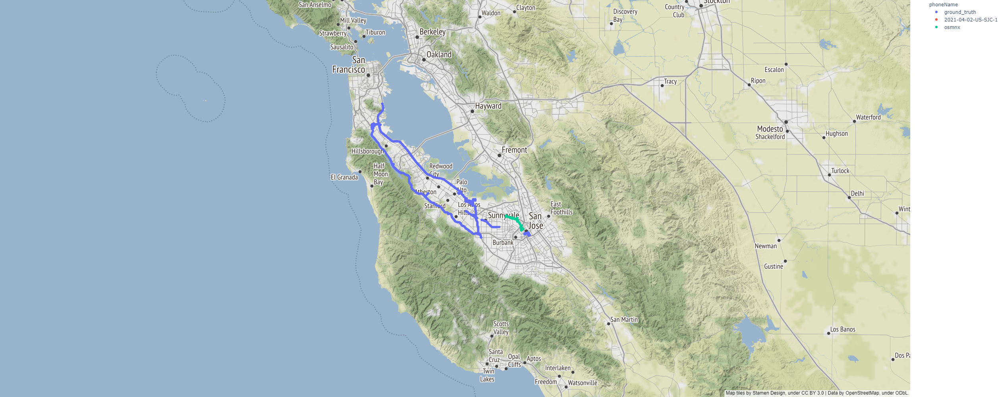

In [25]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = test.copy()
tmp2['phoneName'] = target
tmp3 = line_points.copy()
tmp3['phoneName'] = 'osmnx'
tmp = pd.concat([tmp1, tmp2, tmp3])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

In [26]:
line_points[['latDeg', 'lngDeg']].to_csv(f'{INPUT}/prep/osmnx/{target}.csv', index=False)